
# Gapminder Data Analysis

## Table of Contents
<ul>
<li><a href="#intro">Introduction</a></li>
<li><a href="#wrangling">Data Wrangling</a></li>
<li><a href="#eda">Exploratory Data Analysis</a></li>
<li><a href="#conclusions">Conclusions</a></li>
</ul>

<a id='intro'></a>
## Introduction

> **Dataset**: I have selected Gapminder dataset (*Child mortality, Children per woman, income per person, population and life expectancy*).<br> Child mortality contains data from 1800 to 2018 and it shows the number of children died before the age of five (out of 1000). Similar to child mortality, children per woman dataset contains data from 1800 to 2018 for every country. The number shows how many children a woman has on average in each country in a given year. Incom per person shows how income changes every year for each country from 1800 to 2018. This data also contains a projection from 2019 to 2040. Population data includes data from 1800 to 2018 and projected data from 2019 to 2100. And finally, life expectancy shows, how long people live in each country. <br>
My purpose is to analyze each dataset separately and see the relationship between them and answer the following questions:
<br><br>
> **Question 1**: Which countries are among the top 10 countries in each dataset each year?
<br>
> **Question 2**: How child per woman and child mortality impact population and income per person? 
<br>
**Question 3**: How child per woman correlates with life expectancy?


<a id='wrangling'></a>
## Data Wrangling

In [1]:
#importing the required packages
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.animation as animation
from IPython.display import HTML
import seaborn as sn
from matplotlib.offsetbox import OffsetImage,AnnotationBbox
import plotly_express as px
%matplotlib inline

In [2]:
#readng the data
df_children_per_woman = pd.read_csv('children_per_woman_total_fertility.csv')
df_child_mortality = pd.read_csv('child_mortality_0_5_year_olds_dying_per_1000_born.csv')
df_life_expectancy = pd.read_csv('life_expectancy_years.csv')
df_income = pd.read_csv('income_per_person_gdppercapita_ppp_inflation_adjusted.csv')
df_continent = pd.read_csv('countries_of_the_world.csv',encoding = "ISO-8859-1")
df_population = pd.read_csv('population_total.csv')
df_flags = pd.read_csv('Country_Flags.csv')

In [3]:
#see the shape of the data
print(df_children_per_woman.shape)
print(df_child_mortality.shape)
print(df_life_expectancy.shape)
print(df_income.shape)
print(df_population.shape)

(184, 220)
(193, 220)
(187, 220)
(193, 242)
(195, 302)


In [4]:
df_children_per_woman.head()

,country,1800,1801,1802,1803,1804,1805,1806,1807,1808,...,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018
0,Afghanistan,7.00,7.00,7.00,7.00,7.00,7.00,7.00,7.00,7.00,...,6.04,5.82,5.60,5.38,5.17,4.98,4.80,4.64,4.48,4.33
1,Albania,4.60,4.60,4.60,4.60,4.60,4.60,4.60,4.60,4.60,...,1.65,1.65,1.67,1.69,1.70,1.71,1.71,1.71,1.71,1.71
2,Algeria,6.99,6.99,6.99,6.99,6.99,6.99,6.99,6.99,6.99,...,2.83,2.89,2.93,2.94,2.92,2.89,2.84,2.78,2.71,2.64
3,Angola,6.93,6.93,6.93,6.93,6.93,6.93,6.93,6.94,6.94,...,6.24,6.16,6.08,6.00,5.92,5.84,5.77,5.69,5.62,5.55
4,Antigua and Barbuda,5.00,5.00,4.99,4.99,4.99,4.98,4.98,4.97,4.97,...,2.15,2.13,2.12,2.10,2.09,2.08,2.06,2.05,2.04,2.03


>This data have more than 200 columns which are hard to work with. We can siplyfy it and have only three columns (Country, year and value). I did it with melt function:

In [5]:
df_child_m = pd.melt(df_child_mortality, id_vars=['country'],var_name=['year'])
df_cpw = pd.melt(df_children_per_woman,id_vars=['country'],var_name=['year'])
df_life = pd.melt(df_life_expectancy, id_vars=['country'],var_name=['year'])
df_incom = pd.melt(df_income,id_vars=['country'],var_name=['year'])
df_population = pd.melt(df_population,id_vars=['country'],var_name=['year'])
df_continent = df_continent[['Country','Region']]

In [6]:
df_cpw.head()

,country,year,value
0,Afghanistan,1800,7.00
1,Albania,1800,4.60
2,Algeria,1800,6.99
3,Angola,1800,6.93
4,Antigua and Barbuda,1800,5.00


>This data is easier to work with comparing to the one with 220 columns.

In [7]:
#Column names should be changed to be more readable
df_child_m.rename(columns={'value':'ChildMortality'},inplace=True)
df_child_m.sort_values(['country','year'],inplace=True)
df_cpw.rename(columns={'value':'ChildPerWoman'},inplace=True)
df_cpw.sort_values(['country','year'],inplace=True)
df_life.rename(columns={'value':'LifeExpectancy'},inplace=True)
df_life.sort_values(['country','year'],inplace=True)
df_incom.rename(columns={'value':'income'},inplace=True)
df_incom.sort_values(['country','year'],inplace=True)
df_population.rename(columns={'value':'population'},inplace=True)
df_population.sort_values(['country','year'],inplace=True)

> As we have all the data in a same format (Country, year and value) it is better to merge them. This way we have all the data in same dataset.

In [8]:
df=df_child_m.merge(df_cpw, how='outer', left_on=['country','year'], right_on=['country','year']).merge(df_life, how='outer',left_on=['country','year'],right_on=['country','year']).merge(df_incom,how='outer',left_on=['country','year'],right_on=['country','year']).merge(df_population,how='outer',left_on=['country','year'],right_on=['country','year'])

In [9]:
df.head()

,country,year,ChildMortality,ChildPerWoman,LifeExpectancy,income,population
0,Afghanistan,1800,469.0,7.0,28.2,603.0,3280000
1,Afghanistan,1801,469.0,7.0,28.2,603.0,3280000
2,Afghanistan,1802,469.0,7.0,28.2,603.0,3280000
3,Afghanistan,1803,469.0,7.0,28.2,603.0,3280000
4,Afghanistan,1804,469.0,7.0,28.2,603.0,3280000


> **Adding region of countries:** In this dataset we do not have data about region of countries. We need this data for better visualzation. Here we add region of each country to the dataset. For example, North America for Canada and Asia for China.

In [10]:
# Triming the continent dataset
df_continent['Country'] = df_continent['Country'].apply(lambda x: x.strip())
df_continent['Region'] = df_continent['Region'].apply(lambda x: x.strip())

In [11]:
#Adding region
df = df.merge(df_continent, how='outer',left_on=['country'], right_on=['Country'])
del df['Country']
#df = df.merge(df_flags, how='outer', left_on=['country'], right_on=['country'])

In [12]:
df.head()

,country,year,ChildMortality,ChildPerWoman,LifeExpectancy,income,population,Region
0,Afghanistan,1800,469.0,7.0,28.2,603.0,3280000.0,ASIA (EX. NEAR EAST)
1,Afghanistan,1801,469.0,7.0,28.2,603.0,3280000.0,ASIA (EX. NEAR EAST)
2,Afghanistan,1802,469.0,7.0,28.2,603.0,3280000.0,ASIA (EX. NEAR EAST)
3,Afghanistan,1803,469.0,7.0,28.2,603.0,3280000.0,ASIA (EX. NEAR EAST)
4,Afghanistan,1804,469.0,7.0,28.2,603.0,3280000.0,ASIA (EX. NEAR EAST)


In [13]:
df.describe()

,ChildMortality,ChildPerWoman,LifeExpectancy,income,population
count,40659.000000,40296.000000,40437.000000,46513.000000,5.869500e+04
mean,288.487701,5.400408,43.132180,6392.946467,2.327764e+07
std,162.329771,1.635006,16.313553,13446.715240,1.005185e+08
min,1.950000,1.120000,1.000000,247.000000,6.420000e+02
25%,134.000000,4.590000,31.200000,917.000000,4.390000e+05
50%,356.000000,5.940000,35.500000,1640.000000,2.590000e+06
75%,420.000000,6.610000,56.000000,4800.000000,1.090000e+07
max,756.000000,8.870000,84.200000,182000.000000,1.680000e+09


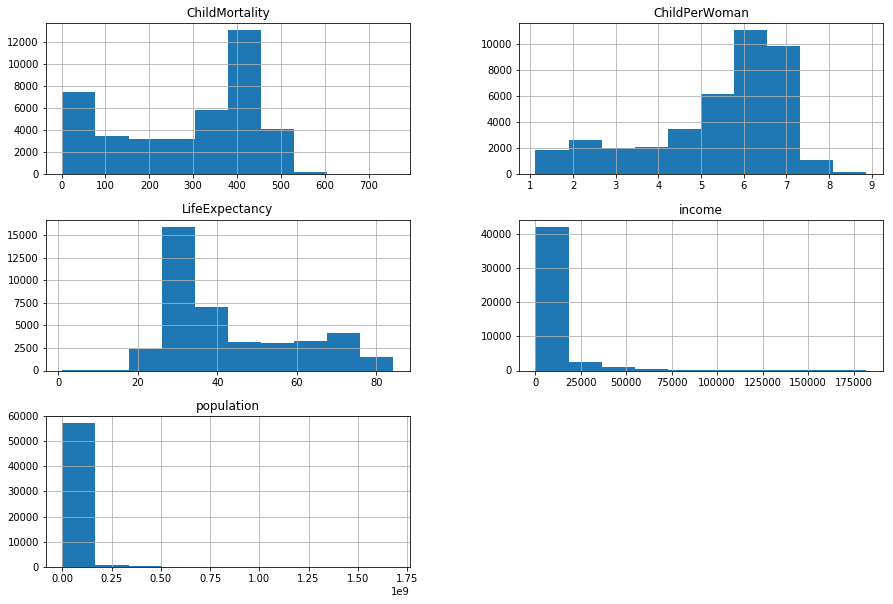

In [14]:
#Histogram of the dataframe
df.hist(figsize=(15,10));

### Data Cleaning

In [15]:
#Removing data after 2018, we don't want to see approximate data of future 
df = df[df['year'] < str(2019)]
df = df.reset_index()
del df['index']

In [16]:
# Check how many missing data we have for each column
df.isna().sum()

country              0
year                 0
ChildMortality    2046
ChildPerWoman     2409
LifeExpectancy    2268
income             438
population           0
Region             219
dtype: int64

In [17]:
#Removing countries with more than 50% missing data in each category 

# Specifying the percentage of data to include the country 
acceptedPresentage = 0.5
# This line groups the data based on countries and shows how much data we have. 
# For example, for Andorra, only 14.16% of the data for child mortality has been recorded. The rest is missing.
mp = df.groupby('country').apply(lambda x: x.notnull().mean())
# This line filters countries with less than 50% missing data
excludedCountries = mp[(mp['ChildMortality'] < acceptedPresentage) | (mp['ChildPerWoman'] < acceptedPresentage) | (mp['LifeExpectancy'] < acceptedPresentage) | (mp['income'] < acceptedPresentage)]['country']

In [34]:
# 1.0 means we do not have any missing data for the country and column. For example, we have all the child mortality data for Afghanistan
# Numbers less than 1 (k) means we have 1-k *100 missing data. For example for child mortality in Andora we have (1 - 0.146119 * 100) = 85.3881 % missing data
mp.head()

,country,year,ChildMortality,ChildPerWoman,LifeExpectancy,income,population,Region
country,,,,,,,,
Afghanistan,1.0,1.0,1.000000,1.0,1.000000,1.0,1.0,1.0
Albania,1.0,1.0,1.000000,1.0,1.000000,1.0,1.0,1.0
Algeria,1.0,1.0,1.000000,1.0,1.000000,1.0,1.0,1.0
Andorra,1.0,1.0,0.146119,0.0,0.214612,1.0,1.0,1.0
Angola,1.0,1.0,1.000000,1.0,1.000000,1.0,1.0,1.0


In [19]:
excludedCountries = list(excludedCountries.index)
excludedCountries
#The following countries will be removed as they have too many missing data

['Andorra',
 'Dominica',
 'Holy See',
 'Liechtenstein',
 'Marshall Islands',
 'Monaco',
 'Nauru',
 'Palau',
 'San Marino',
 'St. Kitts and Nevis',
 'Tuvalu']

In [20]:
df = df[~df['country'].isin(excludedCountries)]

In [21]:
df.count()

country           40296
year              40296
ChildMortality    40294
ChildPerWoman     40296
LifeExpectancy    40296
income            40296
population        40296
Region            40296
dtype: int64

In [22]:
#filling the null data with the next year value(backward fill) if the last data  and forward to make sure a
df= df.groupby('country', as_index=False).apply(lambda group: group.fillna(method='bfill'))
df= df.groupby('country', as_index=False).apply(lambda group: group.fillna(method='ffill'))

In [23]:
# Check how many missing data we have for each column
df.isna().sum()

country           0
year              0
ChildMortality    0
ChildPerWoman     0
LifeExpectancy    0
income            0
population        0
Region            0
dtype: int64

<a id='eda'></a>
## Exploratory Data Analysis

### Question 1 ( Which countries are among the top 10 countries in each dataset each year?)

> It is important to understand how data is changed during the time. For this purpose I show the whole data in a race bar chart.

> To have a better visualization I have added flag of each country to the bar chart.

In [24]:
# This function gets the flage image of a country.
def get_flag(name):
    path = 'flags\{}.gif'.format(name.title())
    im = plt.imread(path)
    return im

# This method sets the flag image to the chart
def offset_image(coord, name, ax):
    img = get_flag(name)
    im = OffsetImage(img, zoom=0.1)
    im.image.axes = ax
    ab = AnnotationBbox(im, (0,coord),  xybox=(-35., 0.), frameon=False,
                        xycoords='data',  boxcoords="offset points", pad=0)
    ax.add_artist(ab)


In [25]:
# We need different color for each region
colors = dict(zip(['ASIA (EX. NEAR EAST)','BALTICS','C.W. OF IND. STATES','EASTERN EUROPE','LATIN AMER. & CARIB','NEAR EAST','NORTHERN AFRICA','NORTHERN AMERICA','OCEANIA','SUB-SAHARAN AFRICA','WESTERN EUROPE'],
                  ['#E57373'                ,'#F06292'   ,'#BA68C8'                  ,'#9575CD'             ,'#7986CB'                  ,'#64B5F6'   ,'#4FC3F7'              ,'#4DD0E1'          ,'#4DB6AC'      ,'#81C784'                 ,'#FF8A65']))
region = df.set_index('country')['Region'].to_dict()
# This method draws a bar chart for a given dataset and year
def draw(year, col, asce):
    columnName = col 
    df_top10 = (df[df['year']==str(year)]).sort_values(by= columnName, ascending = asce).head(10)
    df_top10 = df_top10[::-1] 
    ax.clear()
    ax.barh(df_top10['country'],df_top10[columnName],color=[colors[region[x]] for x in df_top10['country']]);
    #ax.text(1, 0.4, year, transform=ax.transAxes, size=46, ha='right')
    
    for i, (value, name) in enumerate(zip(df_top10[columnName], df_top10['country'])):
        ax.text(value, i,     name,            ha='right', size = 25)  # Tokyo: name
        ax.text(value, i,     value,           ha='left', size = 20)   # 38194.2: value
    
    ax.tick_params(axis='x', which='major', pad=26)
    for i, c in enumerate(df_top10['country']):
        offset_image(i, c, ax)
        ax.text(1, 0.1, year, transform=ax.transAxes, color='#777777', size=46, ha='right', weight=800)
        #ax.text(1, 0.0, 'Total: '+ str(round(sum(df_population[df_population['year']==str(year)]['population']),1)), transform=ax.transAxes, color='#777777', size=30, ha='right', weight=800)     
    ax.text(0, 1.06, columnName, transform=ax.transAxes, size=15, color='#777777')
    ax.xaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'))
    ax.xaxis.set_ticks_position('top')
    ax.tick_params(axis='x', colors='#777777', labelsize=12)
    ax.set_yticks([])
    ax.margins(0, 0.01)
    ax.grid(which='major', axis='x', linestyle='-')
    ax.set_axisbelow(True)
    
    if asce:
        asceText= 'lowest'
    else:
        asceText='highest'
    
    ax.text(0, 1.12, 'Top 10 countries with '+asceText+' '+columnName,
            transform=ax.transAxes, size=24, weight=600, ha='left')
    plt.box(False)


### Life expectancy ranking:
> Life expectancy is one of the critical statistical measures that indicate how well developed a country is. The highest life expectancy has been doubled during the last two centuries from 42 (Iceland in 1800) to 84.2 (Japan in 2018).  Western europian countries with the highest life expectancy almost all the time. The US was among the top 10 until 1961, but not after that. Canada was among the top 10 until 2007. After 1895 Australia and Newzealand joined the countries with the highest life expectancy. After 1970 Japan joined the other developed countries and ranked the highest after 1984 until 2018. Singapour ranked under ten after 1998 and remained in second place after japan.

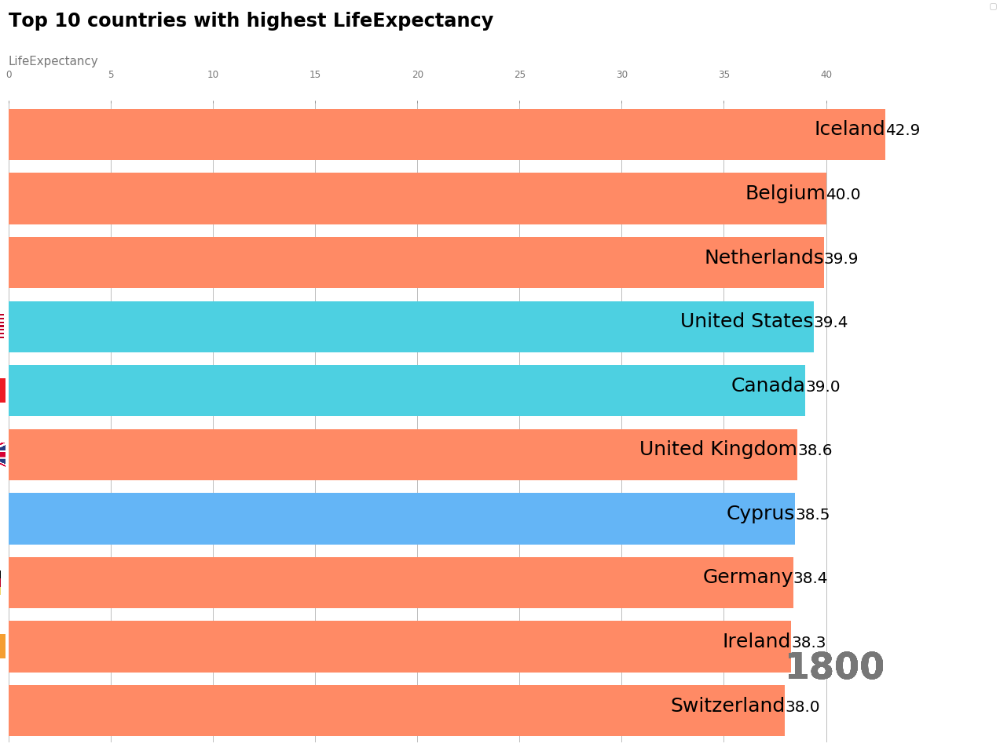

In [26]:
# This cell animates the race bar chart for LifeExpectancy

plt.rcParams['animation.embed_limit'] = 2**128
fig, ax = plt.subplots(figsize=(20,15))
fig.legend(colors)
colName = "LifeExpectancy"
animator = animation.FuncAnimation(fig, draw, fargs=(colName,False,), frames=range(1800, 2019), interval=200)
HTML(animator.to_jshtml())

### Child mortality:
Child mortality refers to the death of children under five years old. This number for the best countries in the world was more than 320 per 1000 in 1800. Now child mortality is less than 3 per 1000 children, which is a huge improvement. Similar to life expectancy, European countries are among the top 10 countries almost all the time. 

In [27]:
# This cell animates the race bar chart for ChildMortality

#To see the race bar chart uncomment the following lines and run the cell
#colName = "ChildMortality"
#animator = animation.FuncAnimation(fig, draw, fargs=(colName,True), frames=range(1800, 2019), interval=200)
#HTML(animator.to_jshtml())

### Child per woman:
> Child per woman or fertility rate is the average number of children that would be born to a woman over her lifetime. This number has been decreased for all the countries in the world. 

In [28]:
# This cell animates the race bar chart for ChildPerWoman

#To see the race bar chart uncomment the following lines and run the cell
#colName = "ChildPerWoman"
#animator = animation.FuncAnimation(fig, draw, fargs=(colName,True), frames=range(1800, 2019), interval=200)
#HTML(animator.to_jshtml())

### Income:
> Income of people in different countries has been increased during the last two centuries. From 1800 to 1850, the top 10 reachest countries were mostly European and the US. After 1850 Australia, Newzealand and Uruguay joined them and were among the top 10 for almost 80 years. Brunei dominated the income per person for almost 25 years from 1942 to 1965. After those Arab countries grew very well and dominated the top 10.

In [37]:
# This cell animates the race bar chart for ChildPerWoman

#To see the race bar chart uncomment the following lines and run the cell
#colName = "income"
#animator = animation.FuncAnimation(fig, draw, fargs=(colName,False), frames=range(1800, 2019), interval=200)
#HTML(animator.to_jshtml())

###  Question 2  (How child per woman, child mortality and life expectancy correlates with income per person? )

### Life expectancy:
> Income and life expectancy have a positive correlation. Life expectancy and income have increased hand in hand during the last 200 years. There are some abrupt changes for some countries during some years that show something has happened. For example, there is a huge drop in life expectancy for chana in 1959, which great china famine happened. A huge drop in life expectancy happened around 1916 (World war 1) for most of the countries around the world. After World war 2, life expectancy started to grow faster than before. 
By tracking some countries that were in a war, it is evident that war harmed people's income. For example, in 2003, the revenue for Iraqi people dropped dramatically.

In [39]:
fig = px.scatter(df, x='income',y='LifeExpectancy', animation_frame='year',animation_group='country', size='population',hover_name='country',
           range_x=[100,100000], range_y=[30,90], log_x= True, size_max=45, color = 'Region')
fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 30
fig.show()

### Child per woman:
> Generally, countries with fewer children per woman have more income. Child per woman has decreased during hast two centuries almost for all the nations. After 1980 African countries had the fewest decrease. As of 2018, the highest child per woman is for African countries, from 3.5 to 7 children per woman.

In [40]:
#To see the scatter plot uncomment the following lines and run the cell
fig = px.scatter(df, x='income',y='ChildPerWoman', animation_frame='year',animation_group='country', size='population',hover_name='country',
           range_x=[100,100000], range_y=[1,10], log_x = True, size_max=45, color = 'Region')
fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 25
fig.show()

### Child Mortality:
>Child mortality has decreased al around the world during the last two centories. 

In [32]:
#To see the scatter plot uncomment the following lines and run the cell
#fig = px.scatter(df, x='income',y='ChildMortality', animation_frame='year',animation_group='country', size='population',hover_name='country',
           #range_x=[100,100000], range_y=[-50,600], log_x = True, size_max=45, color = 'Region')
#fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 25
#fig.show()

### Question 3  (How child per woman correlates with life expectancy? )
> Child per woman and life expectancy have a negative correlation. The less the child per woman, the more the life expectancy. African countries and Afganistan have the shortest life expectancy and more child per woman. Developed countries such as Japan and western European countries have a longer life expectancy and lower child per woman.

In [33]:
#To see the scatter plot uncomment the following lines and run the cell
#fig = px.scatter(df, y='ChildPerWoman',x='LifeExpectancy', animation_frame='year',animation_group='country', size='population',hover_name='country',
           #range_y=[1,10], range_x=[10,90], log_x = False, size_max=45, color = 'Region')
#fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 25
#fig.show()

<a id='conclusions'></a>
## Conclusions

> **Question 1**: 
<br>
For all three categories (Life expectancy, child mortality and child per woman), European countries are dominant on top of the charts every year. Countries such as Japan, Singapour, Canada, Australia and the US are among the top 10 most of the time.

> **Question 2**: 
<br>
Life expectancy and income have a positive correlation: Countries with higher income have higher life expectancies.
Child per woman and income have a negative correlation: people of countries with fewer children per woman earn more money.
Child mortality and income have negative correlation: people of countries with less child mortality earn more money.
<br>

> **Question 3**: 
<br>
Child per woman and life expectancy have a negative correlation: people of countries with fewer children per woman live longer.

### Limitations
> I have faced two main limitation in this analysis. First, I have eliminated some countries due to a lack of enough data (more than 50% missing data). Therefore, our analysis does not include those countries (Andorra, Dominica, Holy See, Liechtenstein, Marshall Islands, Monaco, Nauru, Palau, San Marino, St. Kitts and Nevis, Tuvalu). Second, I filled the missing data with next year's data. In case of any change during those years we are missing them.